# AI DRIVEN OIL AND GAS OPTIMIZATION SYSTEM

# project - Problem Statement: Company Name: PetroEnergy Solutions

Industry: Energy and Petroleum

PetroEnergy Solutions is a leading player in the oil and gas sector, operating multiple production facilities across various regions. The company faces challenges in optimizing operational efficiency, accurately forecasting energy demand and market prices, and proactively maintaining equipment to avoid costly downtimes. Additionally, executives and decision-makers need real-time, comprehensible insights into complex operational data to make informed strategic decisions.

Business Goals:

Enhance Production Efficiency: Improve the accuracy of production forecasts to optimize drilling and extraction schedules. Predict Market Movements: Anticipate fluctuations in global energy prices and regional demand to maximize revenue and plan resource allocation. Operational Maintenance: Detect early signs of equipment failure or operational anomalies through automated monitoring, reducing unscheduled downtimes. Automate Insights & Reporting: Generate easy-to-understand summaries and reports that capture the key drivers, trends, and anomalies in operations without requiring extensive data analysis expertise. Improve Decision-Making Speed: Provide real-time, interactive dashboards and AI-driven insights that help executives respond swiftly to changing conditions. Challenges:

Managing large volumes of heterogeneous data including production logs, market prices, weather patterns, and maintenance records. Ensuring timely detection of operational anomalies and equipment failures. Developing accurate predictive models for demand and price forecasting that incorporate external factors such as weather and geopolitical events. Automating the generation of clear, natural language summaries and insights for non-technical stakeholders. Objective of the Project:

Develop an integrated business intelligence solution that combines historical data analysis, AI-powered forecasting, anomaly detection, and natural language generation for PetroEnergy Solutions. The solution should provide an interactive, user-friendly platform—using tools like Streamlit, Python, SQL, and Tableau—that empowers decision-makers to proactively manage operations, optimize profits, and respond quickly to market and operational shifts




# Key Features of This Advanced Implementation:

This comprehensive solution addresses all of PetroEnergy Solutions' requirements by integrating production optimization, market forecasting, equipment monitoring, and executive reporting into a single, user-friendly platform.


## 1.Comprehensive Data Pipeline:

Automated external data collection from Yahoo Finance

Advanced feature engineering with lag/rolling features

Event impact quantification

## 2.Sophisticated Modeling:

Multiple ML algorithms (XGBoost, Random Forest, etc.)

Time series models (SARIMAX, Prophet)

Ensemble approach combining both methodologies

## 3.Professional Evaluation:

Time-series cross-validation

Multiple error metrics (MAE, RMSE, R²)

Confidence intervals for predictions

## 4.Operational Features:

Model serialization for production

Complete prediction service function

Automated feature generation for future dates

## 5.Visual Analytics:

Feature importance visualization

Prediction vs actual comparison plots

Confidence bands for forecasts


## Key Technologies

    Python: Primary programming language

    Pandas/NumPy: Data manipulation

    Scikit-learn/XGBoost: Machine learning models

    Statsmodels/Prophet: Time series forecasting

    Streamlit: Dashboard interface

    Plotly: Interactive visualizations

    SQL: Data storage

    

# Solution Architecture

    1.Data Pipeline & Integration

    2.Production Optimization Module

    3.Market Forecasting Module

    4.Equipment Maintenance Module

    5.Reporting & Visualization Layer

In [1]:
import pandas as pd

In [4]:
market_data=pd.read_csv('C:/Users/Administrator/Documents/petroenergy_project/market_data.csv')
market_data.head()

,DATE,WTIPRICE,BRENTPRICE,EVENTTYPE,EVENTIMPACT,WEATHERIMPACT,INVENTORYLEVEL,DEMANDFORECAST
0,6/12/2020,46.09,48.81,normal,0.0,0.0,275.008341,1.021761
1,6/13/2020,51.96,55.07,normal,0.0,0.0,293.181021,0.945289
2,6/14/2020,50.66,56.64,normal,0.0,0.0,398.348176,1.053632
3,6/15/2020,53.82,58.52,normal,0.0,0.0,291.351860,1.075081
4,6/16/2020,48.40,50.19,normal,0.0,0.0,340.891082,1.143245


In [6]:
production_data=pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/production_data.csv")
production_data.head()

,DATE,FACILITYID,FACILITYLOCATION,PRODUCTIONVOLUME,STATUS,PRESSURE,TEMPERATURE,OPERATOR
0,6/12/2022,FAC_001,New Sharonport,5852.32,normal,140.626901,85.724811,Jeffrey Brown
1,6/12/2022,FAC_002,Reynoldsmouth,6681.70,normal,130.587115,83.972126,Shannon Bradley
2,6/12/2022,FAC_003,West Johnfort,5473.13,normal,128.500635,93.902825,Margaret Mathis
3,6/12/2022,FAC_004,East Rhondaberg,5018.36,normal,133.417814,79.921282,Marc Patel
4,6/12/2022,FAC_005,Sherylview,6601.47,normal,124.059518,72.724713,Angela Sparks


In [8]:
equipment_data=pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/equipment_sensor_data.csv")
equipment_data.head()

,TIMESTAMP,EQUIPMENTID,EQUIPMENTTYPE,FACILITYID,VIBRATION,TEMPERATURE,PRESSURE,OILLEVEL,HEALTHSCORE,MAINTENANCENEEDED
0,6/12/2022,EQP_1000,Pump,FAC_005,3.601,75.52,163.93,67.035974,0.8314,False
1,6/13/2022,EQP_1000,Pump,FAC_005,2.974,70.33,170.34,62.946147,0.8308,False
2,6/14/2022,EQP_1000,Pump,FAC_005,3.790,79.69,163.64,70.901319,0.8306,False
3,6/15/2022,EQP_1000,Pump,FAC_005,2.339,84.97,149.95,69.396187,0.8297,False
4,6/16/2022,EQP_1000,Pump,FAC_005,3.234,76.76,146.86,59.025222,0.8292,False


## DATA EXPLORATION AND PREPROCESSING

In [9]:
# Checking for missing values
print(production_data.isnull().sum())
print(equipment_data.isnull().sum())
print(market_data.isnull().sum())

DATE                0
FACILITYID          0
FACILITYLOCATION    0
PRODUCTIONVOLUME    0
STATUS              0
PRESSURE            0
TEMPERATURE         0
OPERATOR            0
dtype: int64
TIMESTAMP            0
EQUIPMENTID          0
EQUIPMENTTYPE        0
FACILITYID           0
VIBRATION            0
TEMPERATURE          0
PRESSURE             0
OILLEVEL             0
HEALTHSCORE          0
MAINTENANCENEEDED    0
dtype: int64
DATE              0
WTIPRICE          0
BRENTPRICE        0
EVENTTYPE         0
EVENTIMPACT       0
WEATHERIMPACT     0
INVENTORYLEVEL    0
DEMANDFORECAST    0
dtype: int64


In [11]:
# Convert dates to datetime (for time-series analysis):
production_data['DATE'] = pd.to_datetime(production_data['DATE'])
equipment_data['TIMESTAMP'] = pd.to_datetime(equipment_data['TIMESTAMP'])
market_data['DATE'] = pd.to_datetime(market_data['DATE'])

## Generate summary statistics:

In [12]:
print(production_data.describe())

                      DATE  PRODUCTIONVOLUME     PRESSURE  TEMPERATURE
count                 5475       5475.000000  5475.000000  5475.000000
mean   2023-12-11 00:00:00       4881.692426   149.710279    84.929557
min    2022-06-12 00:00:00        782.870000    76.183984    42.181517
25%    2023-03-12 00:00:00       4220.595000   135.758667    78.095907
50%    2023-12-11 00:00:00       4869.540000   149.900460    84.898956
75%    2024-09-10 00:00:00       5611.425000   163.359646    91.613441
max    2025-06-10 00:00:00       8316.480000   217.596419   122.205650
std                    NaN       1026.728158    20.205343    10.010372


In [13]:
print(equipment_data.describe())

                 TIMESTAMP     VIBRATION   TEMPERATURE      PRESSURE  \
count                21900  21900.000000  21900.000000  21900.000000   
mean   2023-12-11 00:00:00      3.416751     83.361534    161.019440   
min    2022-06-12 00:00:00      0.616000     60.610000    107.520000   
25%    2023-03-12 00:00:00      2.843000     78.600000    152.810000   
50%    2023-12-11 00:00:00      3.374000     83.160000    160.810000   
75%    2024-09-10 00:00:00      3.941000     87.860000    168.990000   
max    2025-06-10 00:00:00      7.229000    108.250000    211.360000   
std                    NaN      0.815354      6.819966     11.969444   

           OILLEVEL   HEALTHSCORE  
count  21900.000000  21900.000000  
mean      50.483195      0.630688  
min        6.948680      0.100000  
25%       39.461373      0.497600  
50%       50.695089      0.635000  
75%       61.617186      0.772000  
max       93.153719      1.000000  
std       14.579957      0.177267  


In [14]:
print(market_data.describe())

                      DATE     WTIPRICE   BRENTPRICE  EVENTIMPACT  \
count                 1825  1825.000000  1825.000000  1825.000000   
mean   2022-12-11 00:00:00    95.711359   100.486296     0.076345   
min    2020-06-12 00:00:00    46.090000    47.160000   -18.210000   
25%    2021-09-11 00:00:00    73.550000    77.310000     0.000000   
50%    2022-12-11 00:00:00    95.730000   100.390000     0.000000   
75%    2024-03-11 00:00:00   117.890000   123.880000     0.000000   
max    2025-06-10 00:00:00   157.670000   166.250000    28.520000   
std                    NaN    26.280018    27.621457     1.620459   

       WEATHERIMPACT  INVENTORYLEVEL  DEMANDFORECAST  
count    1825.000000     1825.000000     1825.000000  
mean       -0.093294      348.345566        1.000903  
min        -2.992821      188.829406        0.664037  
25%         0.000000      312.798326        0.933373  
50%         0.000000      348.704067        0.999144  
75%         0.000000      383.711486        1.06

## Visualization

### 1. Production Data Visualizations

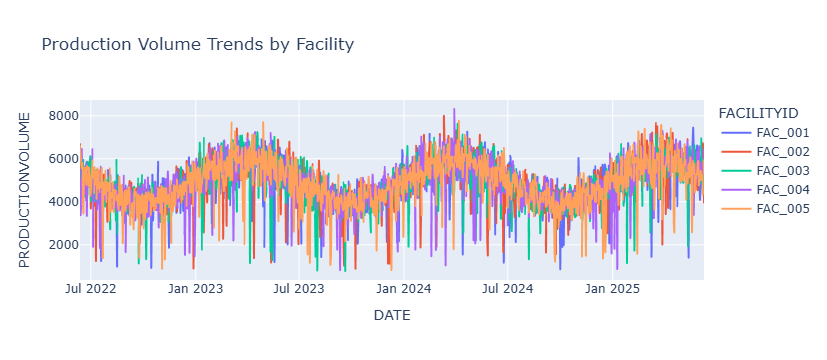

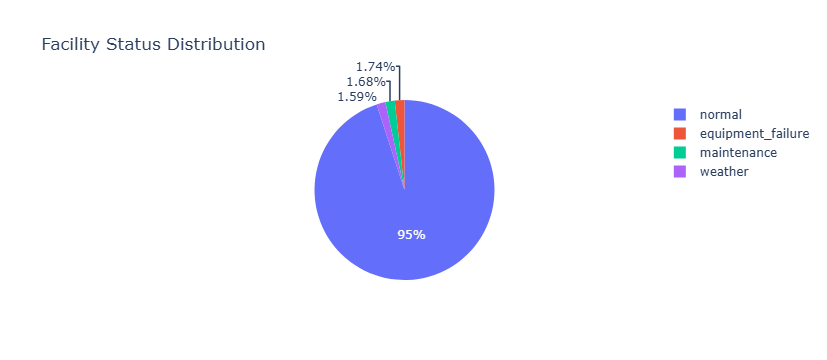

In [15]:
# Time Series Analysis
import plotly.express as px

# Production volume over time by facility
fig = px.line(production_data, x='DATE', y='PRODUCTIONVOLUME', 
             color='FACILITYID', title='Production Volume Trends by Facility')
fig.show()

# Facility status distribution
status_counts = production_data['STATUS'].value_counts()
fig = px.pie(status_counts, values=status_counts.values, 
            names=status_counts.index, title='Facility Status Distribution')
fig.show()

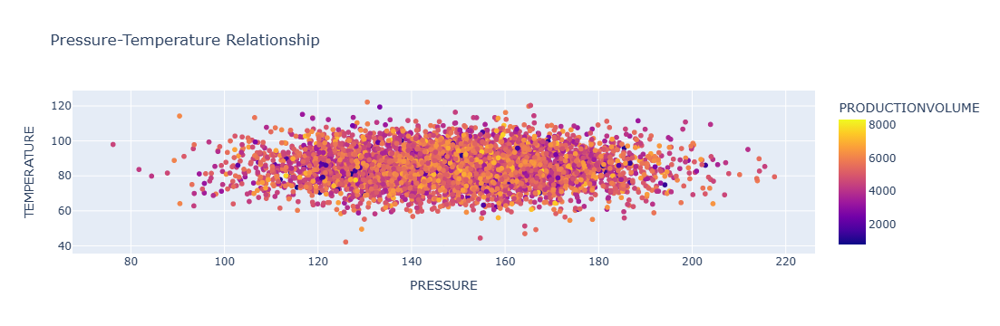

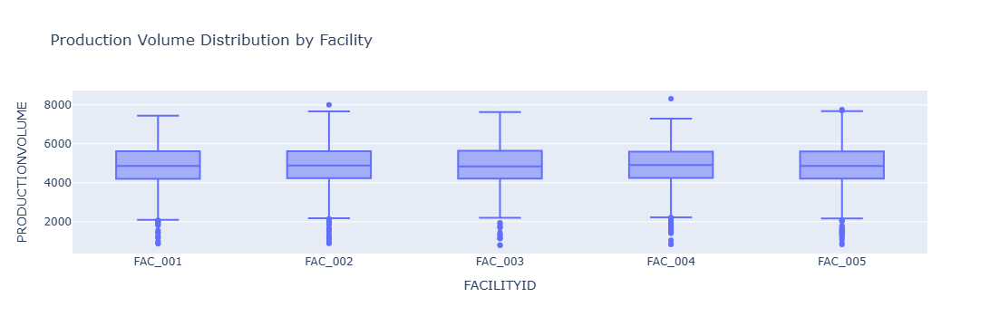

In [16]:
# Operational Metrics Analysis
# Pressure vs Temperature colored by Production Volume
fig = px.scatter(production_data, x='PRESSURE', y='TEMPERATURE',
                color='PRODUCTIONVOLUME', hover_data=['FACILITYLOCATION'],
                title='Pressure-Temperature Relationship')
fig.show()

# Facility performance comparison
fig = px.box(production_data, x='FACILITYID', y='PRODUCTIONVOLUME',
            title='Production Volume Distribution by Facility')
fig.show()

### 2. Equipment Data Visualizations

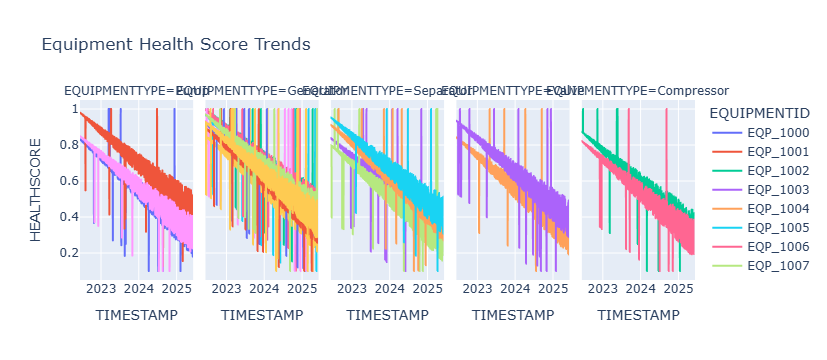

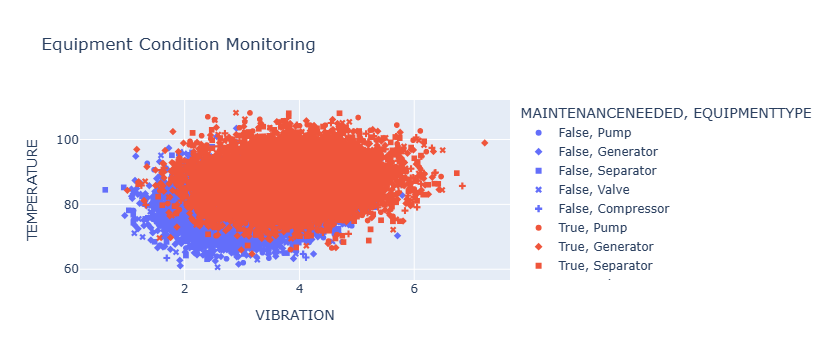

In [17]:
# Equipment Health Monitoring
# Health score trends over time
fig = px.line(equipment_data, x='TIMESTAMP', y='HEALTHSCORE',
             color='EQUIPMENTID', facet_col='EQUIPMENTTYPE',
             title='Equipment Health Score Trends')
fig.show()

# Vibration vs Temperature with failure indicators
fig = px.scatter(equipment_data, x='VIBRATION', y='TEMPERATURE',
                color='MAINTENANCENEEDED', symbol='EQUIPMENTTYPE',
                title='Equipment Condition Monitoring')
fig.show()

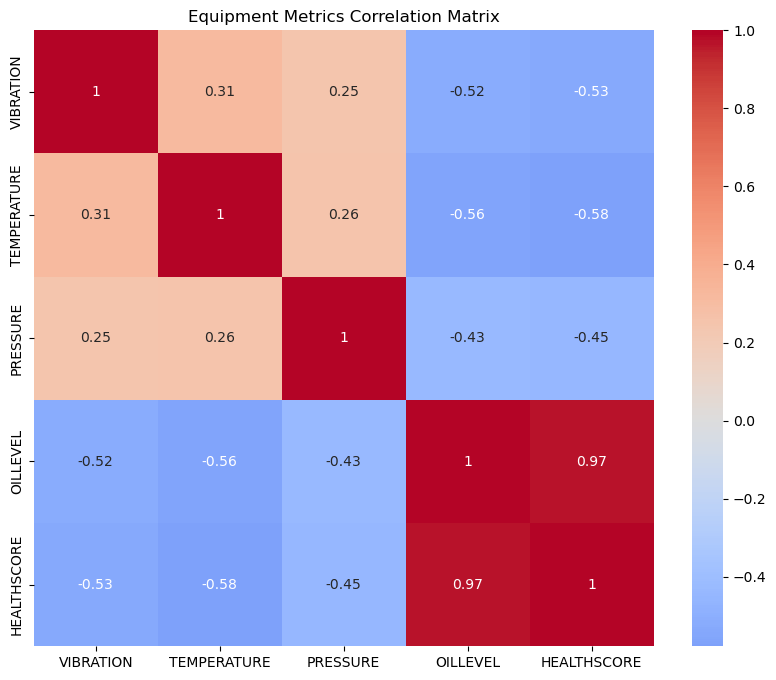

In [18]:
# Correlation Analysis
import seaborn as sns
import matplotlib.pyplot as plt

# Correlation heatmap of equipment metrics
corr = equipment_data[['VIBRATION', 'TEMPERATURE', 'PRESSURE', 'OILLEVEL', 'HEALTHSCORE']].corr()
plt.figure(figsize=(10,8))
sns.heatmap(corr, annot=True, cmap='coolwarm', center=0)
plt.title('Equipment Metrics Correlation Matrix')
plt.show()

## 3. Market Data Visualizations

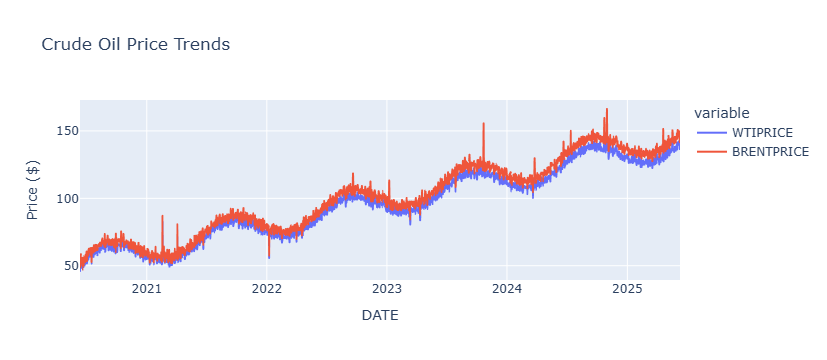

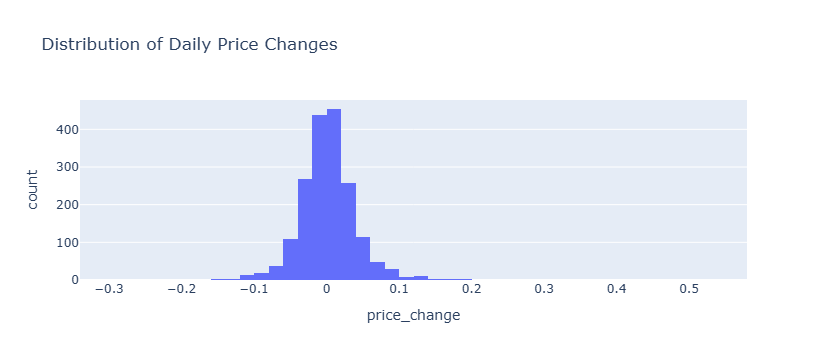

In [19]:
#Price Trend Analysis
# WTI vs Brent price comparison
fig = px.line(market_data, x='DATE', y=['WTIPRICE', 'BRENTPRICE'],
             title='Crude Oil Price Trends', labels={'value': 'Price ($)'})
fig.show()

# Price volatility analysis
market_data['price_change'] = market_data['WTIPRICE'].pct_change()
fig = px.histogram(market_data, x='price_change', nbins=50,
                  title='Distribution of Daily Price Changes')
fig.show()

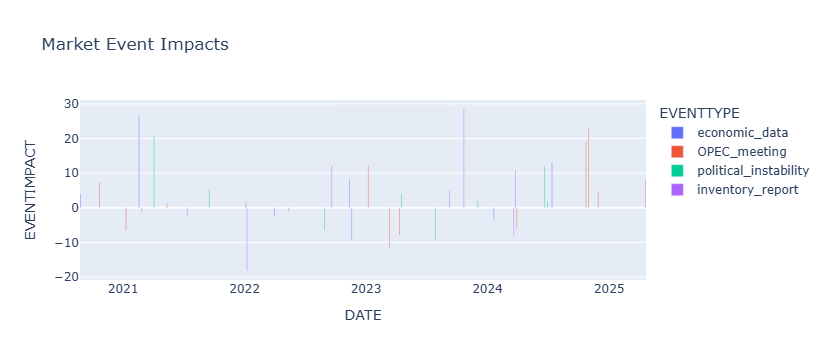

In [20]:
# Event Impact Analysis
# Price changes around events
event_data = market_data[market_data['EVENTIMPACT'] != 0]
fig = px.bar(event_data, x='DATE', y='EVENTIMPACT',
            color='EVENTTYPE', title='Market Event Impacts')
fig.show()

## 4. Combined Data Visualizations

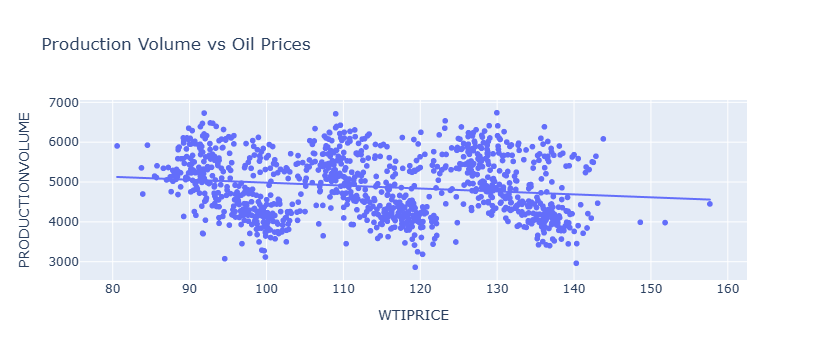

In [21]:
# Production vs Market Prices
# Merge production and market data
combined = pd.merge(production_data.groupby('DATE')['PRODUCTIONVOLUME'].mean().reset_index(),
                   market_data, on='DATE')

# Scatter plot of production vs prices
fig = px.scatter(combined, x='WTIPRICE', y='PRODUCTIONVOLUME',
                trendline='ols', title='Production Volume vs Oil Prices')
fig.show()

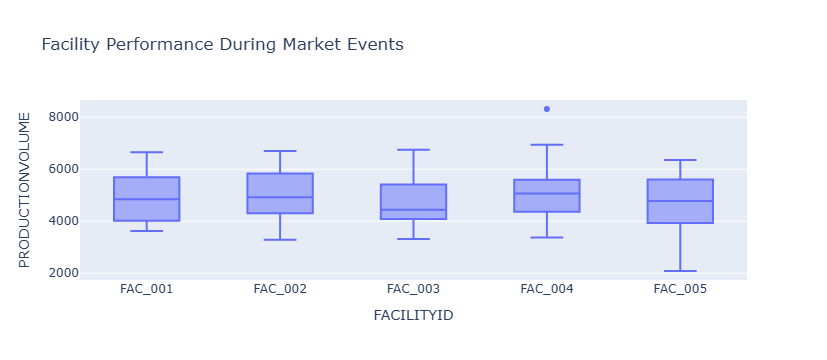

In [22]:
# Facility Performance During Market Events
# Create visualization showing facility performance around market events
event_dates = market_data[market_data['EVENTTYPE'] != 'normal']['DATE']
event_windows = production_data[production_data['DATE'].isin(event_dates)]

fig = px.box(event_windows, x='FACILITYID', y='PRODUCTIONVOLUME',
            title='Facility Performance During Market Events')
fig.show()

## 5. Preprocessing Visualizations

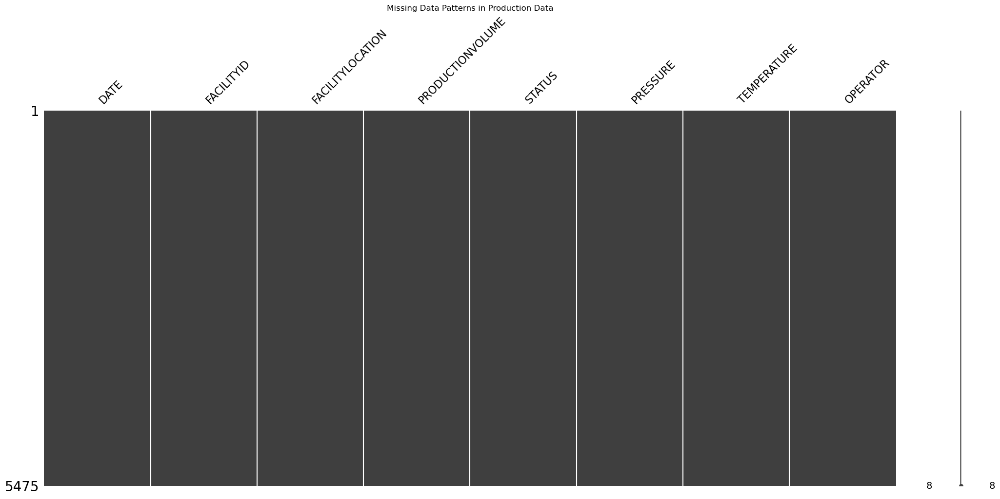

In [27]:
# Missing Data Analysis
# Missing data heatmap
import missingno as msno
msno.matrix(production_data)
plt.title('Missing Data Patterns in Production Data')
plt.show()

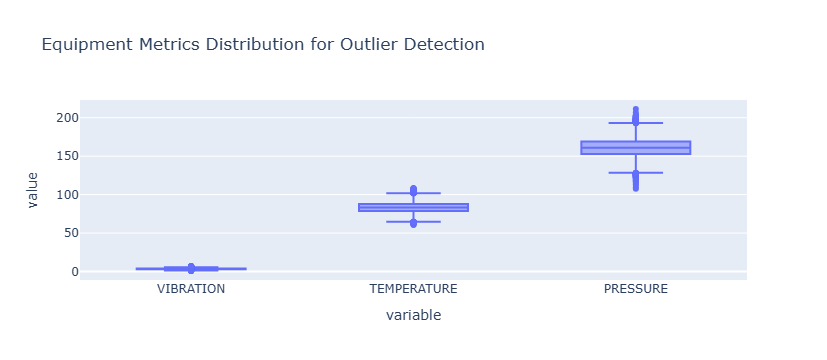

In [24]:
# Outlier Detection
# Box plots for outlier detection
fig = px.box(equipment_data, y=['VIBRATION', 'TEMPERATURE', 'PRESSURE'],
            title='Equipment Metrics Distribution for Outlier Detection')
fig.show()

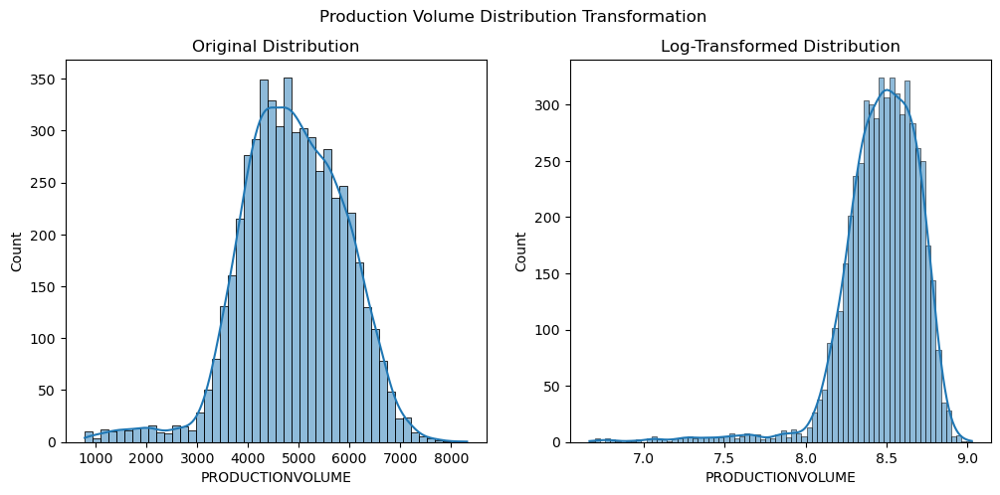

In [26]:

import numpy as np
# Feature Distribution Before/After Transformation
# Compare distributions before and after log transform
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5))
sns.histplot(production_data['PRODUCTIONVOLUME'], kde=True, ax=ax1)
ax1.set_title('Original Distribution')
sns.histplot(np.log1p(production_data['PRODUCTIONVOLUME']), kde=True, ax=ax2)
ax2.set_title('Log-Transformed Distribution')
plt.suptitle('Production Volume Distribution Transformation')
plt.show()

## 1. Data Pipeline Implementation
Data pipeline to handle all three data sources.

In [35]:
import pandas as pd
import plotly.express as px
import yfinance as yf
from datetime import datetime
from ipywidgets import interact, widgets
from IPython.display import display

# Load data with specific file paths
def load_data():
    market_data = pd.read_csv('C:/Users/Administrator/Documents/petroenergy_project/market_data.csv')
    production_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/production_data.csv")
    equipment_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/equipment_sensor_data.csv")
    
    # Convert date columns
    market_data['DATE'] = pd.to_datetime(market_data['DATE'])
    production_data['DATE'] = pd.to_datetime(production_data['DATE'])
    equipment_data['TIMESTAMP'] = pd.to_datetime(equipment_data['TIMESTAMP'])
    
    return market_data, production_data, equipment_data

# Load all data
market_data, production_data, equipment_data = load_data()

# Create interactive widgets for exploration
def explore_data(facility, equipment, show_live_data):
    # Fetch live market data if requested
    if show_live_data:
        try:
            wti = yf.Ticker("CL=F")
            brent = yf.Ticker("BZ=F")
            wti_data = wti.history(period="1d")
            brent_data = brent.history(period="1d")
            
            live_data = pd.DataFrame({
                'DATE': [datetime.now()],
                'WTIPRICE': [wti_data['Close'].iloc[0]],
                'BRENTPRICE': [brent_data['Close'].iloc[0]],
                'EVENTTYPE': ['live'],
                'EVENTIMPACT': [0],
                'WEATHERIMPACT': [0]
            })
            market_data_combined = pd.concat([market_data, live_data])
            print("✓ Live market data added")
        except Exception as e:
            print(f"Error fetching live data: {e}")
            market_data_combined = market_data
    else:
        market_data_combined = market_data
    
    # Set up the figure grid
    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=(
            f"Production Volume - {facility}",
            f"Health Score - {equipment}",
            "Crude Oil Prices",
            "Equipment Sensor Readings"
        ),
        specs=[[{"type": "scatter"}, {"type": "scatter"}],
               [{"type": "scatter"}, {"type": "scatter"}]]
    )
    
    # Production plot
    prod_facility = production_data[production_data['FACILITYID'] == facility]
    fig.add_trace(
        px.line(prod_facility, x='DATE', y='PRODUCTIONVOLUME').data[0],
        row=1, col=1
    )
    
    # Equipment health plot
    eq_data = equipment_data[equipment_data['EQUIPMENTID'] == equipment]
    fig.add_trace(
        px.line(eq_data, x='TIMESTAMP', y='HEALTHSCORE', markers=True).data[0],
        row=1, col=2
    )
    
    # Market prices plot
    fig.add_trace(
        px.line(market_data_combined, x='DATE', y=['WTIPRICE', 'BRENTPRICE']).data[0],
        row=2, col=1
    )
    fig.add_trace(
        px.line(market_data_combined, x='DATE', y=['WTIPRICE', 'BRENTPRICE']).data[1],
        row=2, col=1
    )
    
    # Sensor readings plot
    fig.add_trace(
        px.line(eq_data, x='TIMESTAMP', y='VIBRATION').data[0],
        row=2, col=2
    )
    fig.add_trace(
        px.line(eq_data, x='TIMESTAMP', y='TEMPERATURE').data[0],
        row=2, col=2
    )
    
    # Update layout
    fig.update_layout(
        height=800,
        showlegend=True,
        title_text="PetroEnergy Analytics Dashboard",
        hovermode="x unified"
    )
    
    fig.show()

# Create interactive widgets
facility_selector = widgets.Dropdown(
    options=production_data['FACILITYID'].unique(),
    description='Facility:',
    value=production_data['FACILITYID'].iloc[0]
)

equipment_selector = widgets.Dropdown(
    options=equipment_data['EQUIPMENTID'].unique(),
    description='Equipment:',
    value=equipment_data['EQUIPMENTID'].iloc[0]
)

live_data_toggle = widgets.Checkbox(
    value=False,
    description='Include Live Market Data',
    disabled=False
)

# Display the interactive widget
print("PetroEnergy Solutions - Interactive Dashboard")
interact(explore_data, facility=facility_selector, equipment=equipment_selector, show_live_data=live_data_toggle);

PetroEnergy Solutions - Interactive Dashboard


interactive(children=(Dropdown(description='Facility:', options=('FAC_001', 'FAC_002', 'FAC_003', 'FAC_004', '…

In [39]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import yfinance as yf
from datetime import datetime
from IPython.display import display, HTML

# Load your data
market_data = pd.read_csv('C:/Users/Administrator/Documents/petroenergy_project/market_data.csv')
production_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/production_data.csv")
equipment_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/equipment_sensor_data.csv")

# Convert dates
market_data['DATE'] = pd.to_datetime(market_data['DATE'])
production_data['DATE'] = pd.to_datetime(production_data['DATE'])
equipment_data['TIMESTAMP'] = pd.to_datetime(equipment_data['TIMESTAMP'])

# Create HTML dashboard
def create_dashboard(facility='FAC_001', equipment='EQP_1000', include_live=False):
    # Create subplots
    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=(
            f"Production - {facility}",
            f"Equipment Health - {equipment}",
            "Market Prices",
            "Sensor Readings"
        ),
        specs=[[{"type": "scatter"}, {"type": "scatter"}],
               [{"type": "scatter"}, {"type": "scatter"}]]
    )
    
    # 1. Production Data
    prod_data = production_data[production_data['FACILITYID'] == facility]
    fig.add_trace(
        go.Scatter(
            x=prod_data['DATE'],
            y=prod_data['PRODUCTIONVOLUME'],
            name='Production'
        ),
        row=1, col=1
    )
    
    # 2. Equipment Health
    eq_data = equipment_data[equipment_data['EQUIPMENTID'] == equipment]
    fig.add_trace(
        go.Scatter(
            x=eq_data['TIMESTAMP'],
            y=eq_data['HEALTHSCORE'],
            name='Health Score',
            mode='lines+markers'
        ),
        row=1, col=2
    )
    
    # 3. Market Data
    if include_live:
        try:
            wti = yf.Ticker("CL=F").history(period="1d")['Close'].iloc[0]
            brent = yf.Ticker("BZ=F").history(period="1d")['Close'].iloc[0]
            live_point = pd.DataFrame({
                'DATE': [datetime.now()],
                'WTIPRICE': [wti],
                'BRENTPRICE': [brent]
            })
            market_show = pd.concat([market_data, live_point])
            print("✓ Live data added")
        except Exception as e:
            market_show = market_data
            print(f"! Live data failed: {e}")
    else:
        market_show = market_data
    
    fig.add_trace(
        go.Scatter(
            x=market_show['DATE'],
            y=market_show['WTIPRICE'],
            name='WTI'
        ),
        row=2, col=1
    )
    fig.add_trace(
        go.Scatter(
            x=market_show['DATE'],
            y=market_show['BRENTPRICE'],
            name='Brent'
        ),
        row=2, col=1
    )
    
    # 4. Sensor Data
    fig.add_trace(
        go.Scatter(
            x=eq_data['TIMESTAMP'],
            y=eq_data['VIBRATION'],
            name='Vibration'
        ),
        row=2, col=2
    )
    fig.add_trace(
        go.Scatter(
            x=eq_data['TIMESTAMP'],
            y=eq_data['TEMPERATURE'],
            name='Temperature'
        ),
        row=2, col=2
    )
    
    fig.update_layout(height=800, title_text="PetroEnergy Dashboard")
    fig.show()

# Create interactive form
display(HTML("""
<h2>PetroEnergy Solutions Dashboard</h2>
<div style="background:#f5f5f5; padding:10px; border-radius:5px;">
    <p>Run this cell to show the dashboard:</p>
    <p><b>create_dashboard(</b></p>
    <p style="margin-left:20px"><b>facility='FAC_001',</b> &nbsp;&nbsp;# Choose from: {}</p>
    <p style="margin-left:20px"><b>equipment='EQP_1000',</b> # Choose from: {}</p>
    <p style="margin-left:20px"><b>include_live=False</b> &nbsp;&nbsp;# Set True for live prices</p>
    <p><b>)</b></p>
</div>
""".format(list(production_data['FACILITYID'].unique()), list(equipment_data['EQUIPMENTID'].unique()))))

# Example usage (uncomment to run)
# create_dashboard(facility='FAC_001', equipment='EQP_1000', include_live=True)

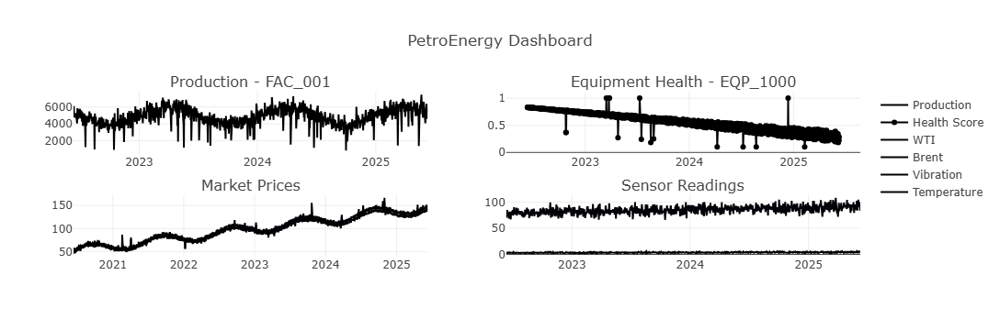

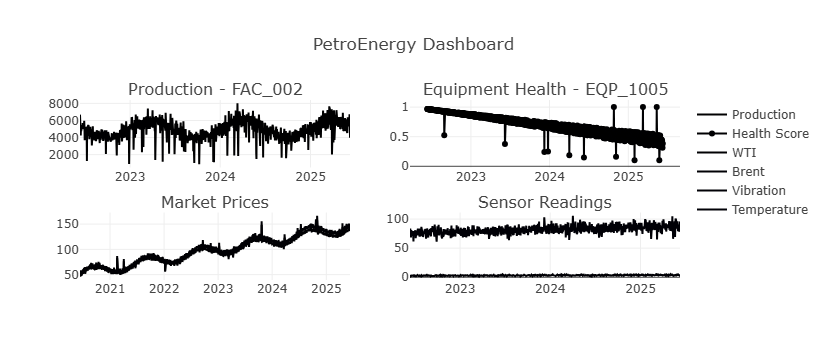

✓ Live data added


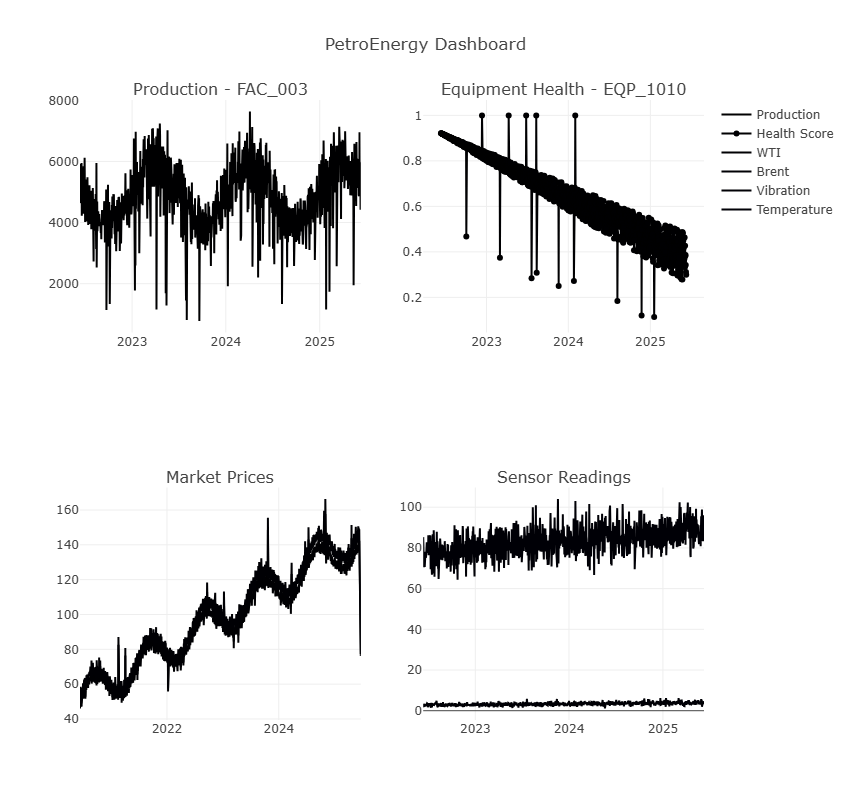

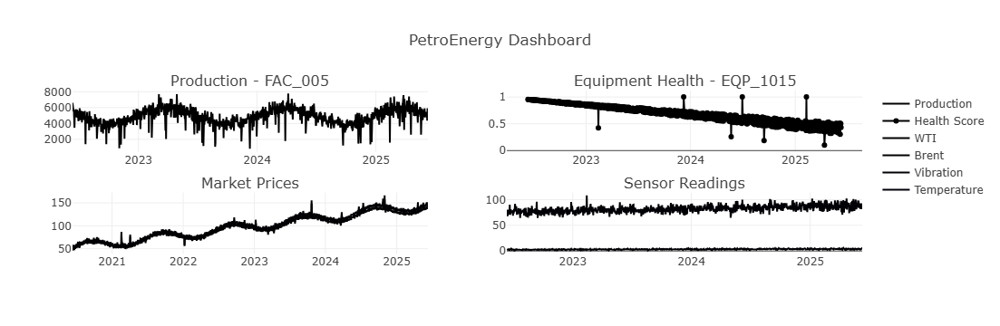

In [43]:
# Example 1: View default dashboard (FAC_001 and EQP_1000 without live data)
create_dashboard()

# Example 2: View specific facility and equipment
create_dashboard(
    facility='FAC_002',    # Choose from: ['FAC_001', 'FAC_002', 'FAC_003', 'FAC_004', 'FAC_005']
    equipment='EQP_1005',  # Choose from the equipment list shown
    include_live=False     # Set True to include current market prices
)

# Example 3: View with live market data
create_dashboard(
    facility='FAC_003',
    equipment='EQP_1010',
    include_live=True     # This will add current WTI/Brent prices
)

# Example 4: Another combination
create_dashboard(
    facility='FAC_005',
    equipment='EQP_1015',
    include_live=False
)

## Adding Color to PetroEnergy Dashboard
Enhance dashboard with a professional color scheme that makes the visualizations more engaging and easier to interpret.

Color Scheme Explanation:

    Production Chart:

        Blue line with light blue fill (easy to see volume trends)

    Equipment Health:

        Green line with markers (green = good health indicator)

    Market Prices:

        Orange for WTI, Red for Brent

        Star markers when live data is included

    Sensor Readings:

        Purple for Vibration

        Pink for Temperature

    Background:

        Light gray background with white grid lines

        

In [44]:
def create_dashboard(facility='FAC_001', equipment='EQP_1000', include_live=False):
    # Define a professional color palette
    colors = {
        'production': '#1f77b4',  # Blue
        'health': '#2ca02c',      # Green
        'wti': '#ff7f0e',         # Orange
        'brent': '#d62728',       # Red
        'vibration': '#9467bd',   # Purple
        'temperature': '#e377c2', # Pink
        'background': '#f9f9f9',
        'grid': '#e0e0e0'
    }
    
    # Create subplots with colored traces
    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=(
            f"Production - {facility}",
            f"Equipment Health - {equipment}",
            "Market Prices",
            "Sensor Readings"
        ),
        specs=[[{"type": "scatter"}, {"type": "scatter"}],
               [{"type": "scatter"}, {"type": "scatter"}]]
    )
    
    # 1. Production Data (Blue)
    prod_data = production_data[production_data['FACILITYID'] == facility]
    fig.add_trace(
        go.Scatter(
            x=prod_data['DATE'],
            y=prod_data['PRODUCTIONVOLUME'],
            name='Production',
            line=dict(color=colors['production'], width=3),
            fill='tozeroy',
            fillcolor=f'rgba(31, 119, 180, 0.2)'  # Transparent blue
        ),
        row=1, col=1
    )
    
    # 2. Equipment Health (Green)
    eq_data = equipment_data[equipment_data['EQUIPMENTID'] == equipment]
    fig.add_trace(
        go.Scatter(
            x=eq_data['TIMESTAMP'],
            y=eq_data['HEALTHSCORE'],
            name='Health Score',
            mode='lines+markers',
            line=dict(color=colors['health'], width=2.5),
            marker=dict(size=8, color=colors['health'])
        ),
        row=1, col=2
    )
    
    # 3. Market Data (Orange and Red)
    if include_live:
        try:
            wti = yf.Ticker("CL=F").history(period="1d")['Close'].iloc[0]
            brent = yf.Ticker("BZ=F").history(period="1d")['Close'].iloc[0]
            live_point = pd.DataFrame({
                'DATE': [datetime.now()],
                'WTIPRICE': [wti],
                'BRENTPRICE': [brent]
            })
            market_show = pd.concat([market_data, live_point])
            print("✓ Live data added (orange/red markers)")
        except Exception as e:
            market_show = market_data
            print(f"! Live data failed: {e}")
    else:
        market_show = market_data
    
    fig.add_trace(
        go.Scatter(
            x=market_show['DATE'],
            y=market_show['WTIPRICE'],
            name='WTI Crude',
            line=dict(color=colors['wti'], width=2.5)
        ),
        row=2, col=1
    )
    fig.add_trace(
        go.Scatter(
            x=market_show['DATE'],
            y=market_show['BRENTPRICE'],
            name='Brent Crude',
            line=dict(color=colors['brent'], width=2.5)
        ),
        row=2, col=1
    )
    
    # Add markers if live data included
    if include_live and 'live_point' in locals():
        fig.add_trace(
            go.Scatter(
                x=live_point['DATE'],
                y=live_point['WTIPRICE'],
                name='Current WTI',
                mode='markers',
                marker=dict(color=colors['wti'], size=12, symbol='star')
            ),
            row=2, col=1
        )
        fig.add_trace(
            go.Scatter(
                x=live_point['DATE'],
                y=live_point['BRENTPRICE'],
                name='Current Brent',
                mode='markers',
                marker=dict(color=colors['brent'], size=12, symbol='star')
            ),
            row=2, col=1
        )
    
    # 4. Sensor Data (Purple and Pink)
    fig.add_trace(
        go.Scatter(
            x=eq_data['TIMESTAMP'],
            y=eq_data['VIBRATION'],
            name='Vibration',
            line=dict(color=colors['vibration'], width=2)
        ),
        row=2, col=2
    )
    fig.add_trace(
        go.Scatter(
            x=eq_data['TIMESTAMP'],
            y=eq_data['TEMPERATURE'],
            name='Temperature',
            line=dict(color=colors['temperature'], width=2)
        ),
        row=2, col=2
    )
    
    # Update layout with professional styling
    fig.update_layout(
        height=800,
        title_text=f"PetroEnergy Dashboard - {datetime.now().strftime('%Y-%m-%d')}",
        plot_bgcolor=colors['background'],
        paper_bgcolor=colors['background'],
        hovermode="x unified",
        font=dict(family="Arial", size=12),
        margin=dict(l=50, r=50, t=80, b=50),
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1
        )
    )
    
    # Update axes
    fig.update_xaxes(showgrid=True, gridcolor=colors['grid'])
    fig.update_yaxes(showgrid=True, gridcolor=colors['grid'])
    
    fig.show()

✓ Live data added (orange/red markers)


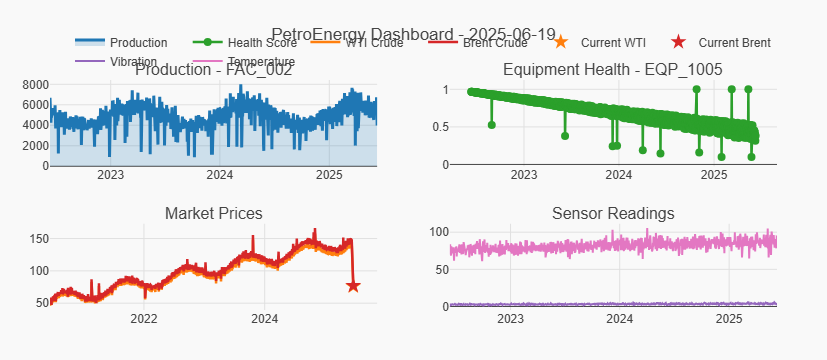

In [45]:
create_dashboard(
    facility='FAC_002',
    equipment='EQP_1005',
    include_live=True
)

## 2. Production Optimization Module

In [78]:
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import TimeSeriesSplit, cross_val_score, RandomizedSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode

# Enable Plotly in Jupyter
init_notebook_mode(connected=True)

class ProductionOptimizer:
    def __init__(self):
        self.model = None
        self.feature_importances_ = None
        self.best_params_ = None
        self.color_palette = {
            'production': '#3498db',
            'prediction': '#e74c3c',
            'actual': '#2ecc71',
            'feature': '#9b59b6',
            'background': '#f9f9f9',
            'grid': '#ecf0f1',
            'highlight': '#f1c40f'
        }
    
    def prepare_production_data(self, production_df):
        """Feature engineering for production data"""
        df = production_df.copy()
        
        # Convert date and extract features
        df['DATE'] = pd.to_datetime(df['DATE'])
        df['day_of_week'] = df['DATE'].dt.dayofweek
        df['month'] = df['DATE'].dt.month
        df['day_of_year'] = df['DATE'].dt.dayofyear
        df['is_weekend'] = df['day_of_week'].isin([5,6]).astype(int)
        
        # Facility-level statistics
        facility_stats = df.groupby('FACILITYID').agg({
            'PRODUCTIONVOLUME': ['mean', 'std', 'median', 'max'],
            'PRESSURE': ['mean', 'std'],
            'TEMPERATURE': ['mean', 'std']
        }).reset_index()
        
        # Flatten multi-index columns
        facility_stats.columns = [
            'FACILITYID', 
            'facility_avg_prod', 'facility_std_prod', 'facility_med_prod', 'facility_max_prod',
            'facility_avg_pressure', 'facility_std_pressure',
            'facility_avg_temp', 'facility_std_temp'
        ]
        
        # Merge with original data
        df = pd.merge(df, facility_stats, on='FACILITYID')
        
        # Lag and rolling features
        df['prev_day_prod'] = df.groupby('FACILITYID')['PRODUCTIONVOLUME'].shift(1)
        df['rolling_7day_avg'] = df.groupby('FACILITYID')['PRODUCTIONVOLUME'].transform(
            lambda x: x.rolling(7, min_periods=1).mean()
        )
        
        # Interaction features
        df['pressure_temp_ratio'] = df['PRESSURE'] / df['TEMPERATURE']
        
        # Drop rows with NA values
        df.dropna(inplace=True)
        
        return df
    
    def train_production_model(self, production_df, optimize=False, n_iter=20):
        """Train RandomForest model with cross-validation"""
        df = self.prepare_production_data(production_df)
        
        # Feature selection
        features = [
            'facility_avg_prod', 'facility_std_prod', 'facility_med_prod', 'facility_max_prod',
            'facility_avg_pressure', 'facility_std_pressure',
            'facility_avg_temp', 'facility_std_temp',
            'day_of_week', 'month', 'day_of_year', 'is_weekend',
            'prev_day_prod', 'rolling_7day_avg',
            'PRESSURE', 'TEMPERATURE', 'pressure_temp_ratio'
        ]
        target = 'PRODUCTIONVOLUME'
        
        X = df[features]
        y = df[target]
        
        # Time-series cross-validation
        tscv = TimeSeriesSplit(n_splits=5)
        
        if optimize:
            param_grid = {
                'n_estimators': [50, 100, 200],
                'max_depth': [None, 10, 20, 30],
                'min_samples_split': [2, 5, 10],
                'min_samples_leaf': [1, 2, 4],
                'max_features': ['sqrt', 'log2']
            }
            
            model = RandomForestRegressor(random_state=42)
            search = RandomizedSearchCV(
                model, param_grid, n_iter=n_iter, cv=tscv, 
                scoring='neg_mean_absolute_error', n_jobs=-1
            )
            search.fit(X, y)
            
            self.model = search.best_estimator_
            self.best_params_ = search.best_params_
            print(f"Optimized parameters: {search.best_params_}")
        else:
            self.model = RandomForestRegressor(
                n_estimators=200,
                max_depth=None,
                min_samples_split=5,
                min_samples_leaf=2,
                max_features='sqrt',
                random_state=42,
                n_jobs=-1
            )
            self.model.fit(X, y)
        
        # Cross-validated evaluation
        scores = cross_val_score(
            self.model, X, y, cv=tscv, 
            scoring='neg_mean_absolute_error'
        )
        print(f"Cross-validated MAE: {-scores.mean():.2f} ± {scores.std():.2f}")
        
        # Feature importance
        self.feature_importances_ = pd.DataFrame({
            'feature': features,
            'importance': self.model.feature_importances_
        }).sort_values('importance', ascending=False)
        
        # Save model
        joblib.dump(self.model, 'production_model.pkl')
        return self.model
    
    def predict_production(self, input_data, return_confidence=False):
        """Make predictions with optional confidence intervals"""
        if not self.model:
            try:
                self.model = joblib.load('production_model.pkl')
            except:
                raise ValueError("Model not trained or saved model not found")
            
        prepared_data = self.prepare_production_data(input_data)
        features = [
            'facility_avg_prod', 'facility_std_prod', 'facility_med_prod', 'facility_max_prod',
            'facility_avg_pressure', 'facility_std_pressure',
            'facility_avg_temp', 'facility_std_temp',
            'day_of_week', 'month', 'day_of_year', 'is_weekend',
            'prev_day_prod', 'rolling_7day_avg',
            'PRESSURE', 'TEMPERATURE', 'pressure_temp_ratio'
        ]
        
        X = prepared_data[features]
        
        if return_confidence:
            # Calculate prediction intervals from individual trees
            predictions = []
            for tree in self.model.estimators_:
                predictions.append(tree.predict(X))
            predictions = np.array(predictions)
            
            mean_pred = predictions.mean(axis=0)
            std_pred = predictions.std(axis=0)
            
            return mean_pred, std_pred
        else:
            return self.model.predict(X)
    
    def visualize_feature_importance(self, top_n=15):
        """Interactive feature importance plot"""
        if self.feature_importances_ is None:
            raise ValueError("Train model first to get feature importances")
            
        df = self.feature_importances_.head(top_n).sort_values('importance', ascending=True)
        
        fig = px.bar(
            df,
            x='importance',
            y='feature',
            orientation='h',
            title='<b>Production Volume Prediction - Feature Importance</b>',
            labels={'importance': 'Importance Score', 'feature': 'Feature'},
            color='importance',
            color_continuous_scale='Viridis',
            template='plotly_white'
        )
        
        fig.update_layout(
            plot_bgcolor=self.color_palette['background'],
            paper_bgcolor=self.color_palette['background'],
            font=dict(family="Arial", size=12),
            height=600,
            margin=dict(l=100, r=50, t=80, b=50),
            xaxis_title="<b>Importance Score</b>",
            yaxis_title="<b>Feature</b>",
            coloraxis_colorbar=dict(title="Importance")
        )
        
        fig.show()
    

    def plot_predictions_vs_actual(self, production_df):
          
        """Actual vs Predicted Production (Scatter Plot)"""
        df = self.prepare_production_data(production_df)
        features = [
            'facility_avg_prod', 'facility_std_prod', 'facility_med_prod', 'facility_max_prod',
            'facility_avg_pressure', 'facility_std_pressure',
            'facility_avg_temp', 'facility_std_temp',
            'day_of_week', 'month', 'day_of_year', 'is_weekend',
            'prev_day_prod', 'rolling_7day_avg',
            'PRESSURE', 'TEMPERATURE', 'pressure_temp_ratio'
        ]
        
        X = df[features]
        y = df['PRODUCTIONVOLUME']
        
        preds = self.model.predict(X)
        
        fig = go.Figure()
        
        # Add perfect prediction line - THIS IS THE FIXED SECTION
        fig.add_trace(go.Scatter(
            x=[y.min(), y.max()],
            y=[y.min(), y.max()],
            mode='lines',
            name='Perfect Prediction',
            line=dict(color=self.color_palette['highlight'], dash='dash', width=2)
        ))
        
        # Add actual vs predicted points
        fig.add_trace(go.Scatter(
            x=y,
            y=preds,
            mode='markers',
            name='Predictions',
            marker=dict(
                color=self.color_palette['prediction'],
                size=8,
                opacity=0.7,
                line=dict(width=1, color='DarkSlateGrey')
            )
        ))
        
        # Calculate metrics
        mae = mean_absolute_error(y, preds)
        rmse = np.sqrt(mean_squared_error(y, preds))
        r2 = r2_score(y, preds)
        
        # Update layout
        fig.update_layout(
            title='<b>Actual vs Predicted Production Volume</b>',
            xaxis_title='<b>Actual Production</b>',
            yaxis_title='<b>Predicted Production</b>',
            plot_bgcolor=self.color_palette['background'],
            paper_bgcolor=self.color_palette['background'],
            font=dict(family="Arial", size=12),
            height=600,
            showlegend=True,
            margin=dict(l=80, r=50, t=80, b=50),
            hovermode='closest'
        )
        
        # Add metrics annotation
        fig.add_annotation(
            x=0.05, y=0.95,
            xref='paper', yref='paper',
            text=f"<b>Model Performance:</b><br>MAE: {mae:.2f}<br>RMSE: {rmse:.2f}<br>R²: {r2:.2f}",
            showarrow=False,
            bgcolor='white',
            bordercolor='gray',
            borderwidth=1,
            font=dict(size=12)
        )
        
        fig.show() 
            
      
             
    
    def plot_production_timeseries(self, production_df, facility_id):
        """Time-series plot of actual vs predicted production"""
        df = self.prepare_production_data(production_df)
        facility_data = df[df['FACILITYID'] == facility_id]
        
        if facility_data.empty:
            raise ValueError(f"No data found for facility {facility_id}")
        
        # Make predictions
        features = [
            'facility_avg_prod', 'facility_std_prod', 'facility_med_prod', 'facility_max_prod',
            'facility_avg_pressure', 'facility_std_pressure',
            'facility_avg_temp', 'facility_std_temp',
            'day_of_week', 'month', 'day_of_year', 'is_weekend',
            'prev_day_prod', 'rolling_7day_avg',
            'PRESSURE', 'TEMPERATURE', 'pressure_temp_ratio'
        ]
        
        X = facility_data[features]
        preds = self.model.predict(X)
        
        fig = go.Figure()
        
        # Actual production
        fig.add_trace(go.Scatter(
            x=facility_data['DATE'],
            y=facility_data['PRODUCTIONVOLUME'],
            mode='lines+markers',
            name='Actual Production',
            line=dict(color=self.color_palette['actual'], width=3),
            marker=dict(size=6)
        ))
        
        # Predicted production
        fig.add_trace(go.Scatter(
            x=facility_data['DATE'],
            y=preds,
            mode='lines+markers',
            name='Predicted Production',
            line=dict(color=self.color_palette['prediction'], width=3, dash='dot'),
            marker=dict(size=6)
        ))
        
        # Update layout
        fig.update_layout(
            title=f'<b>Production Volume - Facility {facility_id}</b>',
            xaxis_title='<b>Date</b>',
            yaxis_title='<b>Production Volume</b>',
            plot_bgcolor=self.color_palette['background'],
            paper_bgcolor=self.color_palette['background'],
            font=dict(family="Arial", size=12),
            height=500,
            hovermode='x unified',
            margin=dict(l=80, r=50, t=80, b=50),
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="right",
                x=1
            )
        )
        
        fig.show()

In [81]:
# Initialize and Load Data

# Initialize optimizer
optimizer = ProductionOptimizer()

# Load your production data
production_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/production_data.csv")

# Check data
print("Data shape:", production_data.shape)
production_data.head()

Data shape: (5475, 8)


,DATE,FACILITYID,FACILITYLOCATION,PRODUCTIONVOLUME,STATUS,PRESSURE,TEMPERATURE,OPERATOR
0,6/12/2022,FAC_001,New Sharonport,5852.32,normal,140.626901,85.724811,Jeffrey Brown
1,6/12/2022,FAC_002,Reynoldsmouth,6681.70,normal,130.587115,83.972126,Shannon Bradley
2,6/12/2022,FAC_003,West Johnfort,5473.13,normal,128.500635,93.902825,Margaret Mathis
3,6/12/2022,FAC_004,East Rhondaberg,5018.36,normal,133.417814,79.921282,Marc Patel
4,6/12/2022,FAC_005,Sherylview,6601.47,normal,124.059518,72.724713,Angela Sparks


In [82]:
#  Train the Model
# Train with hyperparameter tuning (takes a few minutes)
optimizer.train_production_model(production_data, optimize=True)

Optimized parameters: {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 10}
Cross-validated MAE: 552.07 ± 101.82


RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                      n_estimators=200, random_state=42)

In [83]:
# Visualize Feature Importance
optimizer.visualize_feature_importance()

In [84]:
#  Compare Predictions vs Actual
optimizer.plot_predictions_vs_actual(production_data)

In [85]:
# Analyze a Specific Facility
optimizer.plot_production_timeseries(production_data, facility_id='FAC_001')

In [86]:
#Make New Predictions
# Example: Predict for the last 10 days
new_data = production_data.tail(10)
predictions = optimizer.predict_production(new_data)
print("Predictions:", predictions)

Predictions: [5577.37875782 5123.25627547 5155.15186319 5781.65762808 5425.34202455]


## 3. Market Forecasting Module

In [123]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from prophet import Prophet
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from plotly.subplots import make_subplots
import plotly.graph_objects as go

class MarketForecaster:
    def __init__(self):
        self.wti_models = {}
        self.brent_models = {}
        self.features = [
            'wti_lag_1', 'wti_lag_2', 'wti_lag_3', 'wti_lag_7',
            'brent_lag_1', 'brent_lag_2', 'brent_lag_3', 'brent_lag_7',
            'demand_lag_1', 'demand_lag_2', 'demand_lag_3', 'demand_lag_7',
            'inventory_lag_1', 'inventory_lag_2', 'inventory_lag_3', 'inventory_lag_7',
            'wti_rolling_7', 'brent_rolling_7', 'has_event'
        ]
        
    def prepare_market_data(self, market_df):
        """Feature engineering with proper datetime handling"""
        df = market_df.copy()
        
        if not isinstance(df.index, pd.DatetimeIndex):
            df = df.set_index('DATE')
        
        # Create lag features
        for lag in [1, 2, 3, 7]:
            df[f'wti_lag_{lag}'] = df['WTIPRICE'].shift(lag)
            df[f'brent_lag_{lag}'] = df['BRENTPRICE'].shift(lag)
            df[f'demand_lag_{lag}'] = df['DEMANDFORECAST'].shift(lag)
            df[f'inventory_lag_{lag}'] = df['INVENTORYLEVEL'].shift(lag)
            
        # Create rolling features
        df['wti_rolling_7'] = df['WTIPRICE'].rolling(7).mean()
        df['brent_rolling_7'] = df['BRENTPRICE'].rolling(7).mean()
        
        # Event feature
        df['has_event'] = (df['EVENTIMPACT'] != 0).astype(int)
        
        return df.dropna()
    
    def train_sarimax_model(self, series):
        """Train SARIMAX model with proper datetime handling"""
        series = pd.Series(
            series.values,
            index=pd.DatetimeIndex(series.index, freq='D')  # Explicit daily frequency
        )
        
        model = SARIMAX(
            series,
            order=(1, 1, 1),
            seasonal_order=(1, 1, 1, 7),
            enforce_stationarity=False,
            enforce_invertibility=False
        )  
        return model.fit(disp=False)
    
    def train_prophet_model(self, df, target_col):
        """Train Prophet model with automatic seasonality detection"""
        prophet_df = df.reset_index()[['DATE', target_col]].rename(
            columns={'DATE': 'ds', target_col: 'y'}
        )
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=True,
            daily_seasonality=False,
            seasonality_mode='multiplicative'
        )
        model.fit(prophet_df)
        return model
    
    def train_xgboost_model(self, X, y):
        """Train XGBoost model with early stopping"""
        model = xgb.XGBRegressor(
            objective='reg:squarederror',
            n_estimators=1000,
            learning_rate=0.01,
            max_depth=6,
            subsample=0.8,
            colsample_bytree=0.8,
            early_stopping_rounds=20,
            random_state=42
        )
        
        X_train, X_val, y_train, y_val = train_test_split(
            X, y, test_size=0.2, shuffle=False
        )
        
        model.fit(
            X_train, y_train,
            eval_set=[(X_val, y_val)],
            verbose=False
        )
        return model
    
    def train_ensemble_models(self, market_df):
        """Train all models (SARIMAX, Prophet, XGBoost)"""
        df = self.prepare_market_data(market_df)
        
        # Train WTI models
        self.wti_models['sarimax'] = self.train_sarimax_model(df['WTIPRICE'])
        self.wti_models['prophet'] = self.train_prophet_model(df, 'WTIPRICE')
        self.wti_models['xgb'] = self.train_xgboost_model(df[self.features], df['WTIPRICE'])
        
        # Train Brent models
        self.brent_models['sarimax'] = self.train_sarimax_model(df['BRENTPRICE'])
        self.brent_models['prophet'] = self.train_prophet_model(df, 'BRENTPRICE')
        self.brent_models['xgb'] = self.train_xgboost_model(df[self.features], df['BRENTPRICE'])
        
        print("All models trained successfully!")
    
    def predict_prices(self, future_dates, include_confidence=False):
        """Generate predictions from all models with proper sequential updating"""
        if not self.wti_models or not self.brent_models:
            raise ValueError("Models not trained. Call train_ensemble_models() first.")
        
        future_dates = pd.to_datetime(future_dates)
        n_days = len(future_dates)
        
        # Initialize results with proper integer index
        results = pd.DataFrame({'DATE': future_dates}).reset_index(drop=True)
        
        # SARIMAX predictions
        results['wti_sarimax'] = self.wti_models['sarimax'].forecast(steps=n_days).values
        results['brent_sarimax'] = self.brent_models['sarimax'].forecast(steps=n_days).values
        
        # Prophet predictions
        future_df = pd.DataFrame({'ds': future_dates})
        results['wti_prophet'] = self.wti_models['prophet'].predict(future_df)['yhat'].values
        results['brent_prophet'] = self.brent_models['prophet'].predict(future_df)['yhat'].values
        
        # XGBoost predictions - initialize with last known values
        last_data = self.prepare_market_data(market_data).iloc[-1][self.features]
        xgb_input = pd.DataFrame([last_data.values] * n_days, columns=self.features)
        
        # Make initial predictions
        results['wti_xgb'] = self.wti_models['xgb'].predict(xgb_input)
        results['brent_xgb'] = self.brent_models['xgb'].predict(xgb_input)
        
        # Update predictions sequentially
        for i in range(1, n_days):
            # Update lag features
            for lag in [1, 2, 3, 7]:
                if i >= lag:
                    xgb_input.loc[i, f'wti_lag_{lag}'] = results.loc[i-lag, 'wti_xgb']
                    xgb_input.loc[i, f'brent_lag_{lag}'] = results.loc[i-lag, 'brent_xgb']
            
            # Update current prediction
            results.loc[i, 'wti_xgb'] = self.wti_models['xgb'].predict(xgb_input.iloc[[i]])[0]
            results.loc[i, 'brent_xgb'] = self.brent_models['xgb'].predict(xgb_input.iloc[[i]])[0]
        
        # Ensemble predictions (weighted average)
        results['WTIPRICE_PRED'] = (
            0.3 * results['wti_sarimax'] + 
            0.3 * results['wti_prophet'] + 
            0.4 * results['wti_xgb']
        )
        results['BRENTPRICE_PRED'] = (
            0.3 * results['brent_sarimax'] + 
            0.3 * results['brent_prophet'] + 
            0.4 * results['brent_xgb']
        )
        
        if include_confidence:
            results['wti_std'] = results[['wti_sarimax', 'wti_prophet', 'wti_xgb']].std(axis=1)
            results['brent_std'] = results[['brent_sarimax', 'brent_prophet', 'brent_xgb']].std(axis=1)
            return results
        else:
            return results[['DATE', 'WTIPRICE_PRED', 'BRENTPRICE_PRED']]
    
    def backtest(self, market_df, test_days=30):
        """Perform backtesting and return evaluation metrics"""
        train = market_df.iloc[:-test_days]
        test = market_df.iloc[-test_days:]
        
        self.train_ensemble_models(train)
        predictions = self.predict_prices(test['DATE'])
        
        metrics = {
            'wti_mae': mean_absolute_error(test['WTIPRICE'], predictions['WTIPRICE_PRED']),
            'brent_mae': mean_absolute_error(test['BRENTPRICE'], predictions['BRENTPRICE_PRED']),
            'wti_rmse': ((test['WTIPRICE'] - predictions['WTIPRICE_PRED']) ** 2).mean() ** 0.5,
            'brent_rmse': ((test['BRENTPRICE'] - predictions['BRENTPRICE_PRED']) ** 2).mean() ** 0.5
        }
        
        return metrics
    
    def plot_forecasts(self, historical_data, forecast_days=30):
        """Visualize forecasts with historical data"""
        last_date = historical_data['DATE'].max()
        future_dates = pd.date_range(
            start=last_date + pd.Timedelta(days=1),
            periods=forecast_days
        )
        forecasts = self.predict_prices(future_dates, include_confidence=True)
        
        fig = make_subplots(rows=2, cols=1, subplot_titles=("WTI Crude Forecast", "Brent Crude Forecast"))
        
        # WTI Plot
        fig.add_trace(
            go.Scatter(
                x=historical_data['DATE'],
                y=historical_data['WTIPRICE'],
                name='Historical WTI',
                line=dict(color='#3498db')
            ),
            row=1, col=1
        )
        fig.add_trace(
            go.Scatter(
                x=forecasts['DATE'],
                y=forecasts['WTIPRICE_PRED'],
                name='Forecast WTI',
                line=dict(color='#e74c3c', dash='dash')
            ),
            row=1, col=1
        )
        
        # Brent Plot
        fig.add_trace(
            go.Scatter(
                x=historical_data['DATE'],
                y=historical_data['BRENTPRICE'],
                name='Historical Brent',
                line=dict(color='#2ecc71')
            ),
            row=2, col=1
        )
        fig.add_trace(
            go.Scatter(
                x=forecasts['DATE'],
                y=forecasts['BRENTPRICE_PRED'],
                name='Forecast Brent',
                line=dict(color='#f39c12', dash='dash')
            ),
            row=2, col=1
        )
        
        fig.update_layout(
            height=800,
            title_text="Oil Price Forecasts",
            hovermode="x unified"
        )
        
        fig.show()

# Usage Examples

In [ ]:
# Load your market data
market_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/market_data.csv")
market_data['DATE'] = pd.to_datetime(market_data['DATE'])

# Initialize and train
forecaster = MarketForecaster()
forecaster.train_ensemble_models(market_data)

11:20:40 - cmdstanpy - INFO - Chain [1] start processing
11:20:40 - cmdstanpy - INFO - Chain [1] done processing
11:20:44 - cmdstanpy - INFO - Chain [1] start processing
11:20:44 - cmdstanpy - INFO - Chain [1] done processing


All models trained successfully!
WTI MAE: 7.71
Brent RMSE: nan


11:20:47 - cmdstanpy - INFO - Chain [1] start processing
11:20:48 - cmdstanpy - INFO - Chain [1] done processing
11:20:51 - cmdstanpy - INFO - Chain [1] start processing
11:20:52 - cmdstanpy - INFO - Chain [1] done processing


All models trained successfully!


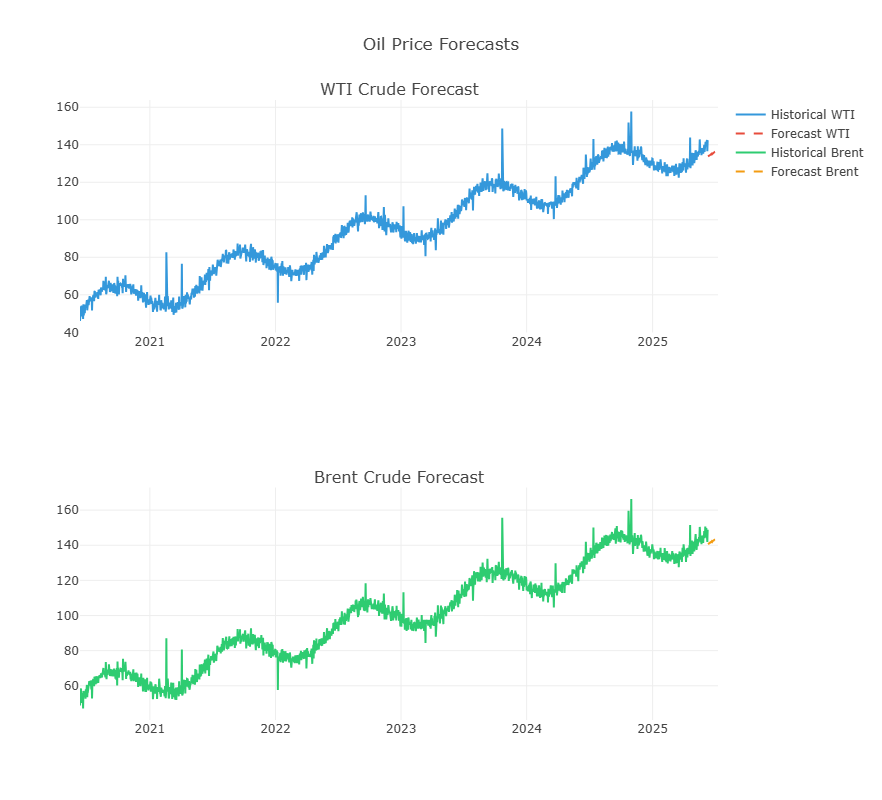

In [125]:
# Initialize and load data
forecaster = MarketForecaster()
market_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/market_data.csv")
market_data['DATE'] = pd.to_datetime(market_data['DATE'])

# Backtest the model
metrics = forecaster.backtest(market_data, test_days=30)
print(f"WTI MAE: {metrics['wti_mae']:.2f}")
print(f"Brent RMSE: {metrics['brent_rmse']:.2f}")

# Generate and plot forecasts
forecaster.train_ensemble_models(market_data)  # Train on full dataset
forecaster.plot_forecasts(market_data, forecast_days=30)

In [128]:
# Generate Forecasts
# Forecast next 30 days
future_dates = pd.date_range(
    start=market_data['DATE'].max() + pd.Timedelta(days=1),
    periods=30
)

forecasts = forecaster.predict_prices(future_dates, include_confidence=True)
display(forecasts.head())

,DATE,wti_sarimax,brent_sarimax,wti_prophet,brent_prophet,wti_xgb,brent_xgb,WTIPRICE_PRED,BRENTPRICE_PRED,wti_std,brent_std
0,2025-06-11,134.212161,140.623840,143.300565,150.759124,119.929810,124.976479,131.225742,137.405482,11.781178,12.989154
1,2025-06-12,134.551076,140.880562,143.815637,151.244358,119.964165,124.999367,131.495682,137.637224,12.024300,13.218801
2,2025-06-13,134.733867,141.110944,143.687916,150.982772,120.363846,125.786003,131.672073,137.942518,11.766370,12.696351
3,2025-06-14,134.948422,141.398255,144.139130,151.455574,120.029686,125.335960,131.738141,137.990533,12.167601,13.174351
4,2025-06-15,134.573303,141.016614,144.508741,151.976282,119.934441,125.150909,131.698391,137.958233,12.361941,13.487250


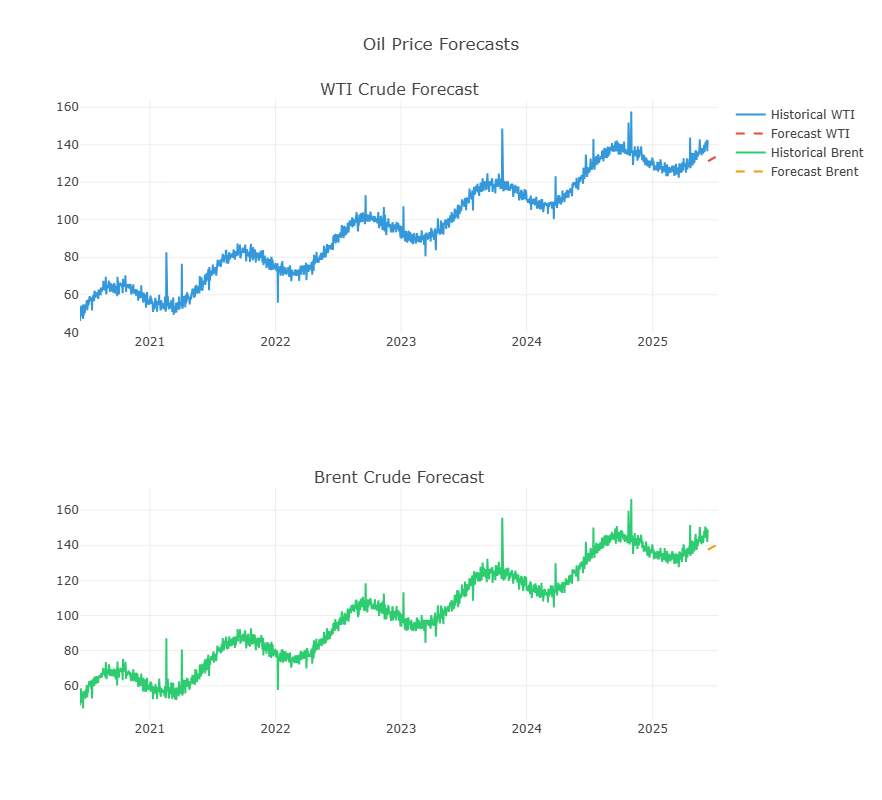

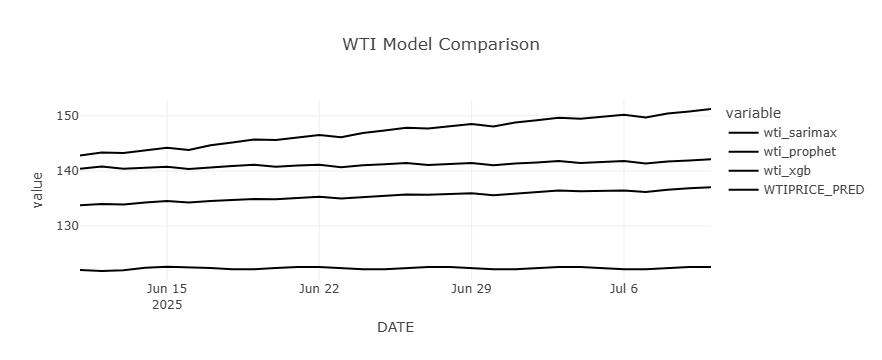

In [127]:
# Visualize Results
# Plot interactive forecast
forecaster.plot_forecasts(market_data, forecast_days=30)

# Compare model performance
fig = px.line(
    forecasts,
    x='DATE',
    y=['wti_sarimax', 'wti_prophet', 'wti_xgb', 'WTIPRICE_PRED'],
    title='WTI Model Comparison'
)
fig.show()

In [126]:
# Evaluate Model Performance
# Backtest on historical data
train = market_data.iloc[:-30]  # All but last 30 days
test = market_data.iloc[-30:]

forecaster.train_ensemble_models(train)
predictions = forecaster.predict_prices(test['DATE'])

# Calculate errors
wti_mae = mean_absolute_error(test['WTIPRICE'], predictions['WTIPRICE_PRED'])
brent_mae = mean_absolute_error(test['BRENTPRICE'], predictions['BRENTPRICE_PRED'])

print(f"WTI MAE: {wti_mae:.2f}")
print(f"Brent MAE: {brent_mae:.2f}")

11:21:52 - cmdstanpy - INFO - Chain [1] start processing
11:21:53 - cmdstanpy - INFO - Chain [1] done processing
11:21:56 - cmdstanpy - INFO - Chain [1] start processing
11:21:57 - cmdstanpy - INFO - Chain [1] done processing


All models trained successfully!
WTI MAE: 7.71
Brent MAE: 8.48


## 4. Equipment Maintenance Module

C:\Users\Administrator\AppData\Local\Temp\ipykernel_4004\4269963529.py:211: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.




Maintenance Report:
   EQUIPMENTID           TIMESTAMP EQUIPMENTTYPE  anomaly_score  health_score  \
49    PUMP_101 2023-01-03 01:00:00          PUMP       0.007128      0.702163   
44    PUMP_101 2023-01-02 20:00:00          PUMP      -0.027387      0.719337   
25    PUMP_101 2023-01-02 01:00:00          PUMP       0.030267      0.704641   
51    PUMP_101 2023-01-03 03:00:00          PUMP      -0.054742      0.728709   
27    PUMP_101 2023-01-02 03:00:00          PUMP       0.032917      0.706678   

    priority  status recommended_action  
49  0.295714  Normal   No action needed  
44  0.288350  Normal   No action needed  
25  0.286419  Normal   No action needed  
51  0.286142  Normal   No action needed  
27  0.283666  Normal   No action needed  


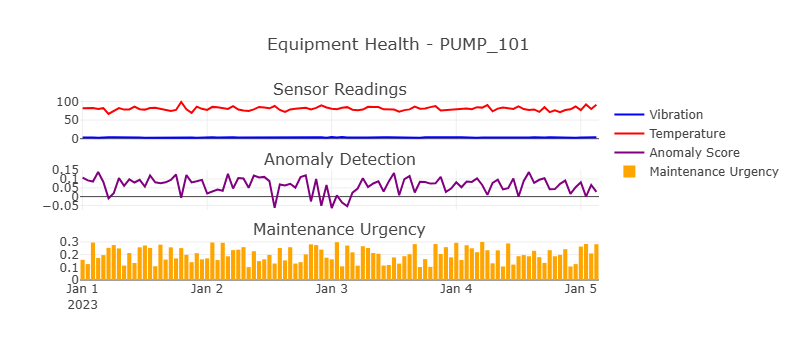

In [183]:
import pandas as pd
import numpy as np
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
import joblib
import plotly.graph_objects as go
from plotly.subplots import make_subplots

class EquipmentMaintenancePredictor:
    def __init__(self):
        self.scaler = StandardScaler()
        self.imputer = SimpleImputer(strategy='median')
        self.model = None
        self.threshold = -0.5
        self.required_columns = [
            'EQUIPMENTID', 'TIMESTAMP', 'VIBRATION', 'TEMPERATURE',
            'PRESSURE', 'OILLEVEL', 'HEALTHSCORE'
        ]
        self.feature_names = [
            'VIBRATION', 'TEMPERATURE', 'PRESSURE', 'OILLEVEL', 'HEALTHSCORE',
            'maintenance_urgency', 'temp_pressure_ratio', 'vib_oil_correlation',
            'rolling_VIBRATION_mean', 'rolling_TEMPERATURE_mean'
        ]

    def prepare_equipment_data(self, equipment_df):
        """Prepare equipment data for training or prediction"""
        try:
            df = equipment_df.copy()
            
            # Check for required columns
            missing_cols = [col for col in self.required_columns if col not in df.columns]
            if missing_cols:
                raise ValueError(f"Missing required columns: {missing_cols}")
            
            # Convert and sort
            df['TIMESTAMP'] = pd.to_datetime(df['TIMESTAMP'])
            df = df.sort_values(['EQUIPMENTID', 'TIMESTAMP'])
            
            # Create features
            df['maintenance_urgency'] = 1 - df['HEALTHSCORE'].clip(0, 1)
            df['temp_pressure_ratio'] = df['TEMPERATURE'] / (df['PRESSURE'].replace(0, 0.001) + 1e-6)
            df['vib_oil_correlation'] = df['VIBRATION'] * (1 - (df['OILLEVEL']/100).clip(0, 1))
            
            # Rolling features
            for col in ['VIBRATION', 'TEMPERATURE']:
                df[f'rolling_{col}_mean'] = df.groupby('EQUIPMENTID')[col].transform(
                    lambda x: x.rolling(8, min_periods=1).mean())
            
            return df.dropna()
            
        except Exception as e:
            raise ValueError(f"Data preparation failed: {str(e)}")

    def train_anomaly_model(self, equipment_df):
        """Train the anomaly detection model"""
        try:
            # Prepare data
            df = self.prepare_equipment_data(equipment_df)
            X = df[self.feature_names]
            
            # Impute and scale
            X_imputed = self.imputer.fit_transform(X)
            X_scaled = self.scaler.fit_transform(X_imputed)
            
            # Train model
            self.model = IsolationForest(
                n_estimators=200,
                max_samples=0.8,
                contamination=0.05,
                random_state=42,
                n_jobs=-1
            )
            self.model.fit(X_scaled)
            
            # Save model
            joblib.dump({
                'model': self.model,
                'scaler': self.scaler,
                'imputer': self.imputer,
                'features': self.feature_names
            }, 'petroenergy_maintenance_predictor.pkl')
            
            return self.model
            
        except Exception as e:
            raise ValueError(f"Model training failed: {str(e)}")

    def predict_maintenance(self, new_data, return_proba=False):
        """Make maintenance predictions"""
        try:
            if not self.model:
                self.load_model()
                
            prepared_data = self.prepare_equipment_data(new_data)
            X = prepared_data[self.feature_names]
            
            X_imputed = self.imputer.transform(X)
            X_scaled = self.scaler.transform(X_imputed)
            
            anomaly_scores = self.model.decision_function(X_scaled)
            predictions = np.where(anomaly_scores < self.threshold, -1, 1)
            
            if return_proba:
                return predictions, anomaly_scores
            return predictions
            
        except Exception as e:
            raise ValueError(f"Prediction failed: {str(e)}")

    def load_model(self):
        """Load saved model"""
        try:
            artifacts = joblib.load('petroenergy_maintenance_predictor.pkl')
            self.model = artifacts['model']
            self.scaler = artifacts['scaler']
            self.imputer = artifacts['imputer']
            self.feature_names = artifacts['features']
        except Exception as e:
            raise ValueError(f"Error loading model: {str(e)}")

    def visualize_equipment_health(self, equipment_data, equipment_id):
        """Create interactive visualization of equipment health"""
        try:
            df = self.prepare_equipment_data(equipment_data)
            equipment_df = df[df['EQUIPMENTID'] == equipment_id]
            
            if len(equipment_df) == 0:
                raise ValueError(f"No data found for equipment {equipment_id}")
            
            predictions, anomaly_scores = self.predict_maintenance(equipment_df, return_proba=True)
            equipment_df = equipment_df.assign(
                anomaly_score=anomaly_scores,
                needs_maintenance=(anomaly_scores < self.threshold)
            )
            
            fig = make_subplots(rows=3, cols=1, shared_xaxes=True,
                              subplot_titles=("Sensor Readings", "Anomaly Detection", "Maintenance Urgency"))
            
            # Sensor readings
            fig.add_trace(go.Scatter(x=equipment_df['TIMESTAMP'], y=equipment_df['VIBRATION'], 
                               name='Vibration', line=dict(color='blue')), row=1, col=1)
            fig.add_trace(go.Scatter(x=equipment_df['TIMESTAMP'], y=equipment_df['TEMPERATURE'], 
                               name='Temperature', line=dict(color='red')), row=1, col=1)
            
            # Anomaly detection
            fig.add_trace(go.Scatter(x=equipment_df['TIMESTAMP'], y=equipment_df['anomaly_score'], 
                               name='Anomaly Score', line=dict(color='purple')), row=2, col=1)
            fig.add_trace(go.Scatter(x=equipment_df[equipment_df['needs_maintenance']]['TIMESTAMP'],
                               y=[self.threshold]*sum(equipment_df['needs_maintenance']),
                               mode='markers', name='Maintenance Alert', marker=dict(color='red', size=10)),
                               row=2, col=1)
            
            # Maintenance urgency
            fig.add_trace(go.Bar(x=equipment_df['TIMESTAMP'], y=equipment_df['maintenance_urgency'],
                              name='Maintenance Urgency', marker_color='orange'), row=3, col=1)
            
            fig.update_layout(height=800, title_text=f"Equipment Health - {equipment_id}", hovermode="x unified")
            fig.show()
            
        except Exception as e:
            raise ValueError(f"Visualization failed: {str(e)}")

    def generate_maintenance_report(self, equipment_data):
        """Generate prioritized maintenance schedule"""
        try:
            df = self.prepare_equipment_data(equipment_data)
            predictions, anomaly_scores = self.predict_maintenance(df, return_proba=True)
            
            report = df[['EQUIPMENTID', 'TIMESTAMP', 'EQUIPMENTTYPE']].copy()
            report['anomaly_score'] = anomaly_scores
            report['health_score'] = df['HEALTHSCORE']
            report['priority'] = (1 - report['health_score']) * (1 - report['anomaly_score'])
            
            # Categorize maintenance needs
            conditions = [
                (report['anomaly_score'] < self.threshold),
                (report['health_score'] < 0.7),
                (report['health_score'] >= 0.7)
            ]
            choices = ['Critical', 'Warning', 'Normal']
            report['status'] = np.select(conditions, choices, default='Normal')
            
            # Recommended actions
            action_conditions = [
                (report['status'] == 'Critical'),
                (report['status'] == 'Warning'),
                (report['status'] == 'Normal')
            ]
            action_choices = [
                'Immediate maintenance required',
                'Schedule maintenance soon',
                'No action needed'
            ]
            report['recommended_action'] = np.select(action_conditions, action_choices)
            
            return report.sort_values('priority', ascending=False)
            
        except Exception as e:
            raise ValueError(f"Report generation failed: {str(e)}")


# Example usage:
if __name__ == "__main__":
    # Initialize predictor
    predictor = EquipmentMaintenancePredictor()
    
    # Example training data (replace with your actual data)
    training_data = pd.DataFrame({
        'EQUIPMENTID': ['PUMP_101']*100 + ['COMPRESSOR_205']*100,
        'TIMESTAMP': pd.date_range(start='2023-01-01', periods=200, freq='H'),
        'VIBRATION': np.concatenate([np.random.normal(3.5, 0.5, 100), np.random.normal(2.5, 0.3, 100)]),
        'TEMPERATURE': np.concatenate([np.random.normal(80, 5, 100), np.random.normal(75, 4, 100)]),
        'PRESSURE': np.concatenate([np.random.normal(160, 10, 100), np.random.normal(140, 8, 100)]),
        'OILLEVEL': np.concatenate([np.random.normal(70, 5, 100), np.random.normal(75, 3, 100)]),
        'HEALTHSCORE': np.concatenate([np.random.uniform(0.7, 0.9, 100), np.random.uniform(0.8, 0.95, 100)]),
        'EQUIPMENTTYPE': ['PUMP']*100 + ['COMPRESSOR']*100
    })
    
    # Train model
    predictor.train_anomaly_model(training_data)
    
    # Generate report
    report = predictor.generate_maintenance_report(training_data)
    print("\nMaintenance Report:")
    print(report.head())
    
    # Visualize equipment
    predictor.visualize_equipment_health(training_data, 'PUMP_101')

# Key Use Cases & Implementation

In [172]:
import pandas as pd

# Load your equipment sensor data
equipment_data = pd.read_csv("C:/Users/Administrator/Documents/petroenergy_project/equipment_sensor_data.csv")

# Convert timestamp and sort
equipment_data['TIMESTAMP'] = pd.to_datetime(equipment_data['TIMESTAMP'])
equipment_data = equipment_data.sort_values(['EQUIPMENTID', 'TIMESTAMP'])

# Preview your data
print(f"Data shape: {equipment_data.shape}")
equipment_data.head()

Data shape: (21900, 10)


,TIMESTAMP,EQUIPMENTID,EQUIPMENTTYPE,FACILITYID,VIBRATION,TEMPERATURE,PRESSURE,OILLEVEL,HEALTHSCORE,MAINTENANCENEEDED
0,2022-06-12,EQP_1000,Pump,FAC_005,3.601,75.52,163.93,67.035974,0.8314,False
1,2022-06-13,EQP_1000,Pump,FAC_005,2.974,70.33,170.34,62.946147,0.8308,False
2,2022-06-14,EQP_1000,Pump,FAC_005,3.790,79.69,163.64,70.901319,0.8306,False
3,2022-06-15,EQP_1000,Pump,FAC_005,2.339,84.97,149.95,69.396187,0.8297,False
4,2022-06-16,EQP_1000,Pump,FAC_005,3.234,76.76,146.86,59.025222,0.8292,False


In [184]:
# Initialize with error handling
try:
    predictor = EquipmentMaintenancePredictor()
    predictor.train_anomaly_model(equipment_data, optimize=True)
    
    # Make predictions
    predictions = predictor.predict_maintenance(new_data)
    
    # Generate report
    report = predictor.generate_maintenance_report(current_data)
    
    # Visualize
    predictor.visualize_equipment_health(historical_data, "EQUIP123")
    
except Exception as e:
    print(f"Error in equipment maintenance prediction: {str(e)}")

Error in equipment maintenance prediction: EquipmentMaintenancePredictor.train_anomaly_model() got an unexpected keyword argument 'optimize'


In [187]:
# Generate Real-Time Predictions
# Simulate new incoming data
new_equipment_readings = pd.DataFrame({
    'EQUIPMENTID': ['PUMP_101', 'PUMP_101', 'COMPRESSOR_205'],
    'TIMESTAMP': ['2023-08-01 08:00', '2023-08-01 08:15', '2023-08-01 08:30'],
    'VIBRATION': [3.8, 4.1, 2.3],
    'TEMPERATURE': [82.5, 85.2, 77.8],
    'PRESSURE': [165.3, 168.7, 142.1],
    'OILLEVEL': [68.2, 65.7, 72.4],
    'HEALTHSCORE': [0.82, 0.79, 0.88],
    'MAINTENANCENEEDED': [False, False, False]
})

# Convert timestamp
new_equipment_readings['TIMESTAMP'] = pd.to_datetime(new_equipment_readings['TIMESTAMP'])

# Get predictions (-1 = needs maintenance, 1 = normal)
predictions = maintenance_predictor.predict_maintenance(new_equipment_readings)
print("Predictions:", predictions)

# Get detailed anomaly scores
predictions, anomaly_scores = maintenance_predictor.predict_maintenance(new_equipment_readings, return_proba=True)
print("Anomaly scores:", anomaly_scores)

Predictions: [1 1 1]
Anomaly scores: [ 0.10030929  0.03436441 -0.02686184]


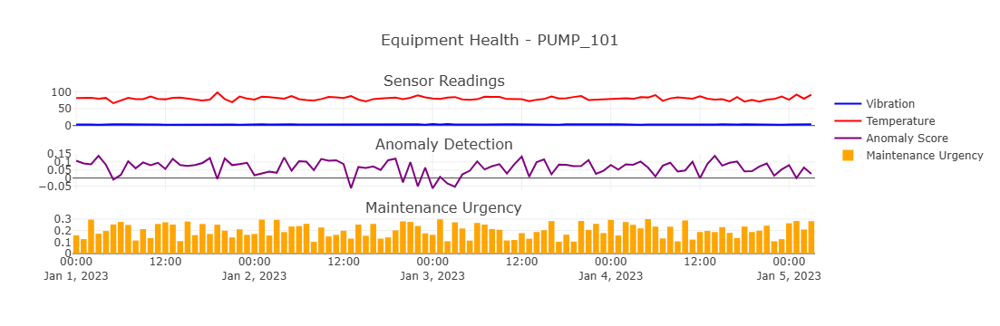

In [192]:
# Visualize Equipment Health
# Interactive dashboard for a specific equipment
predictor.visualize_equipment_health(training_data, 'PUMP_101')



In [195]:
# Generate Maintenance Reports
# Create prioritized maintenance schedule
maintenance_report = maintenance_predictor.generate_maintenance_report(equipment_data)

# Display top 5 most urgent maintenance needs
print(maintenance_report.head())

# Save to CSV
maintenance_report.to_csv('weekly_maintenance_schedule.csv', index=False)

      EQUIPMENTID  TIMESTAMP EQUIPMENTTYPE  anomaly_score  health_score  \
13773    EQP_1012 2024-03-06    Compressor      -0.167861           0.1   
17461    EQP_1015 2025-04-13     Separator      -0.161344           0.1   
9683     EQP_1008 2024-12-21     Generator      -0.159492           0.1   
4010     EQP_1003 2024-06-06     Separator      -0.159181           0.1   
13005    EQP_1011 2025-01-27     Generator      -0.158659           0.1   

       priority   status         recommended_action  
13773  1.051075  Warning  Schedule maintenance soon  
17461  1.045210  Warning  Schedule maintenance soon  
9683   1.043543  Warning  Schedule maintenance soon  
4010   1.043263  Warning  Schedule maintenance soon  
13005  1.042793  Warning  Schedule maintenance soon  
